High-plex multiomic analysis in ffpe tissue at single-cellular and subcellular resolution by spatial molecular imaging

ShortName: he2022high

Steps of processing the data from raw to Anndata:

In [1]:
# 1, Download the raw data from http://nanostring.com/CosMx-dataset

In [2]:
import os
import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
from SOView import *

/home/yzy/anaconda3/envs/SODB/lib/python3.9/site-packages/tqdm-4.64.1-py3.9.egg/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


scanpy==1.9.1 anndata==0.8.0 umap==0.5.2 numpy==1.23.3 scipy==1.9.1 pandas==1.5.0 scikit-learn==1.0.2 statsmodels==0.13.2 python-igraph==0.9.9 pynndescent==0.5.6
squidpy==1.1.2


In [3]:
path = '/home/yzy/PUBDT/st/dsp/he2022high'

In [4]:
sample_list = os.listdir(f'{path}/raw')

In [5]:
sample_list

['Lung5_Rep2',
 'Lung5_Rep3',
 'Lung9_Rep1',
 'Lung12',
 'Lung6',
 'Lung13',
 'Lung9_Rep2',
 'Lung5_Rep1']

In [15]:
exprMat = 'exprMat_file.csv'
fovPos = 'fov_positions_file.csv'
metaData = 'metadata_file.csv'
tx = 'tx_file.csv'

In [16]:
exprMat_pd = pd.read_csv(f'{path}/raw/{sample_list[0]}/{exprMat}',delimiter=',')
fovPos_pd =  pd.read_csv(f'{path}/raw/{sample_list[0]}/{fovPos}',delimiter=',')
metaData_pd =  pd.read_csv(f'{path}/raw/{sample_list[0]}/{metaData}',delimiter=',')
tx_pd =  pd.read_csv(f'{path}/raw/{sample_list[0]}/{tx}',delimiter=',')

In [21]:
exprMat_pd

,fov,cell_ID,AATK,ABL1,ABL2,ACE,ACE2,ACKR1,ACKR3,ACKR4,...,NegPrb14,NegPrb15,NegPrb16,NegPrb17,NegPrb18,NegPrb19,NegPrb20,NegPrb21,NegPrb22,NegPrb23
0,1,0,26,8,10,57,53,22,10,10,...,28,20,29,4,35,16,10,6,43,49
1,1,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,2,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1,3,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,2,0
4,1,4,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106684,30,4162,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
106685,30,4163,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
106686,30,4164,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
106687,30,4165,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [19]:
metaData_pd

,fov,cell_ID,Area,AspectRatio,CenterX_local_px,CenterY_local_px,CenterX_global_px,CenterY_global_px,Width,Height,Mean.MembraneStain,Max.MembraneStain,Mean.PanCK,Max.PanCK,Mean.CD45,Max.CD45,Mean.CD3,Max.CD3,Mean.DAPI,Max.DAPI
0,1,1,2142,1.48,806,3628,8156.000000,162800.222222,59,40,1075,1842,22954,49711,76,385,0,78,1784,11384
1,1,2,2236,2.08,980,3630,8330.000000,162802.222222,75,36,1232,4073,23035,65311,90,10963,0,248,2751,17658
2,1,3,4845,1.15,1637,3607,8987.000000,162779.222222,94,82,4367,11890,1593,26734,225,1329,5,283,8988,35448
3,1,4,2915,1.00,1694,3619,9044.000000,162791.222222,59,59,6017,13814,12387,50409,54,623,0,96,69,3837
4,1,5,8634,1.02,1869,3596,9219.000000,162768.222222,106,104,3945,13832,10624,47795,42,10543,0,85,227,6058
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106655,30,4162,1538,1.67,1179,18,30417.888889,177440.222222,55,33,832,2481,178,474,50,385,0,60,3186,12719
106656,30,4163,1462,2.07,1323,16,30561.888889,177438.222222,60,29,855,2047,152,556,552,2932,0,0,9886,34212
106657,30,4164,747,1.82,3080,12,32318.888889,177434.222222,40,22,1061,1738,139,350,108,392,0,3,5855,12940
106658,30,4165,1303,2.58,4113,14,33351.888889,177436.222222,67,26,2805,6827,148,410,296,1054,0,29,6283,19087


In [ ]:
exprMat_pd[['fov']]

In [23]:
exprMat_pd.loc[0,'fov']

1

In [24]:
exprMat_pd_index = []
for i in range(len(exprMat_pd)):
    fov = exprMat_pd.loc[i,'fov']
    cell_ID = exprMat_pd.loc[i,'cell_ID']
    exprMat_pd_index.append(f'{fov}_{cell_ID}')

In [26]:
metaData_pd_index = []
for i in range(len(metaData_pd)):
    fov = metaData_pd.loc[i,'fov']
    cell_ID = metaData_pd.loc[i,'cell_ID']
    metaData_pd_index.append(f'{fov}_{cell_ID}')

In [29]:
len(exprMat_pd_index)

106689

In [28]:
len(metaData_pd_index)

106660

In [31]:
exprMat_pd.shape

(106689, 982)

In [32]:
exprMat_pd['index'] = exprMat_pd_index
exprMat_pd = exprMat_pd.set_index('index')

In [39]:
metaData_pd

,fov,cell_ID,Area,AspectRatio,CenterX_local_px,CenterY_local_px,CenterX_global_px,CenterY_global_px,Width,Height,Mean.MembraneStain,Max.MembraneStain,Mean.PanCK,Max.PanCK,Mean.CD45,Max.CD45,Mean.CD3,Max.CD3,Mean.DAPI,Max.DAPI
index,,,,,,,,,,,,,,,,,,,,
1_1,1,1,2142,1.48,806,3628,8156.000000,162800.222222,59,40,1075,1842,22954,49711,76,385,0,78,1784,11384
1_2,1,2,2236,2.08,980,3630,8330.000000,162802.222222,75,36,1232,4073,23035,65311,90,10963,0,248,2751,17658
1_3,1,3,4845,1.15,1637,3607,8987.000000,162779.222222,94,82,4367,11890,1593,26734,225,1329,5,283,8988,35448
1_4,1,4,2915,1.00,1694,3619,9044.000000,162791.222222,59,59,6017,13814,12387,50409,54,623,0,96,69,3837
1_5,1,5,8634,1.02,1869,3596,9219.000000,162768.222222,106,104,3945,13832,10624,47795,42,10543,0,85,227,6058
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30_4162,30,4162,1538,1.67,1179,18,30417.888889,177440.222222,55,33,832,2481,178,474,50,385,0,60,3186,12719
30_4163,30,4163,1462,2.07,1323,16,30561.888889,177438.222222,60,29,855,2047,152,556,552,2932,0,0,9886,34212
30_4164,30,4164,747,1.82,3080,12,32318.888889,177434.222222,40,22,1061,1738,139,350,108,392,0,3,5855,12940


In [41]:
metaData_pd['index'] = metaData_pd_index
metaData_pd = metaData_pd.set_index('index')


In [42]:
exprMat_pd = exprMat_pd.loc[metaData_pd.index]

In [44]:
var_names = exprMat_pd.columns[2:]
obs_names = exprMat_pd.index
X = exprMat_pd.values[:,2:]

In [45]:
adata = ad.AnnData(X=X)
adata.obs_names = obs_names
adata.var_names = var_names
for obs in metaData_pd.columns:
    adata.obs[obs] = metaData_pd[[obs]]

/tmp/ipykernel_1126531/884025983.py:1: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = ad.AnnData(X=X)


In [50]:
adata.obsm['spatial'] = np.array(metaData_pd[['CenterX_global_px','CenterY_global_px']]).astype('float')

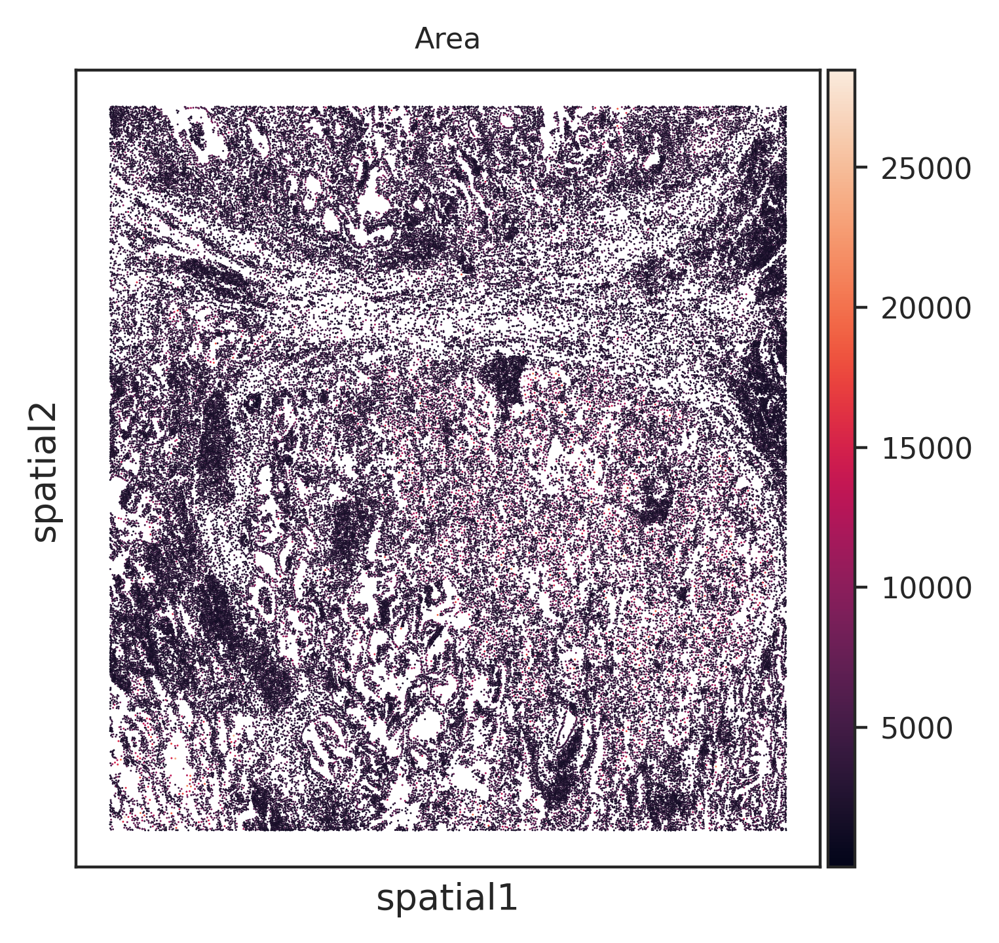

In [53]:
sc.pl.embedding(adata,basis='spatial',color='Area')

# run all

In [56]:
i

106659

/tmp/ipykernel_1126531/2907380336.py:34: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = ad.AnnData(X=X)


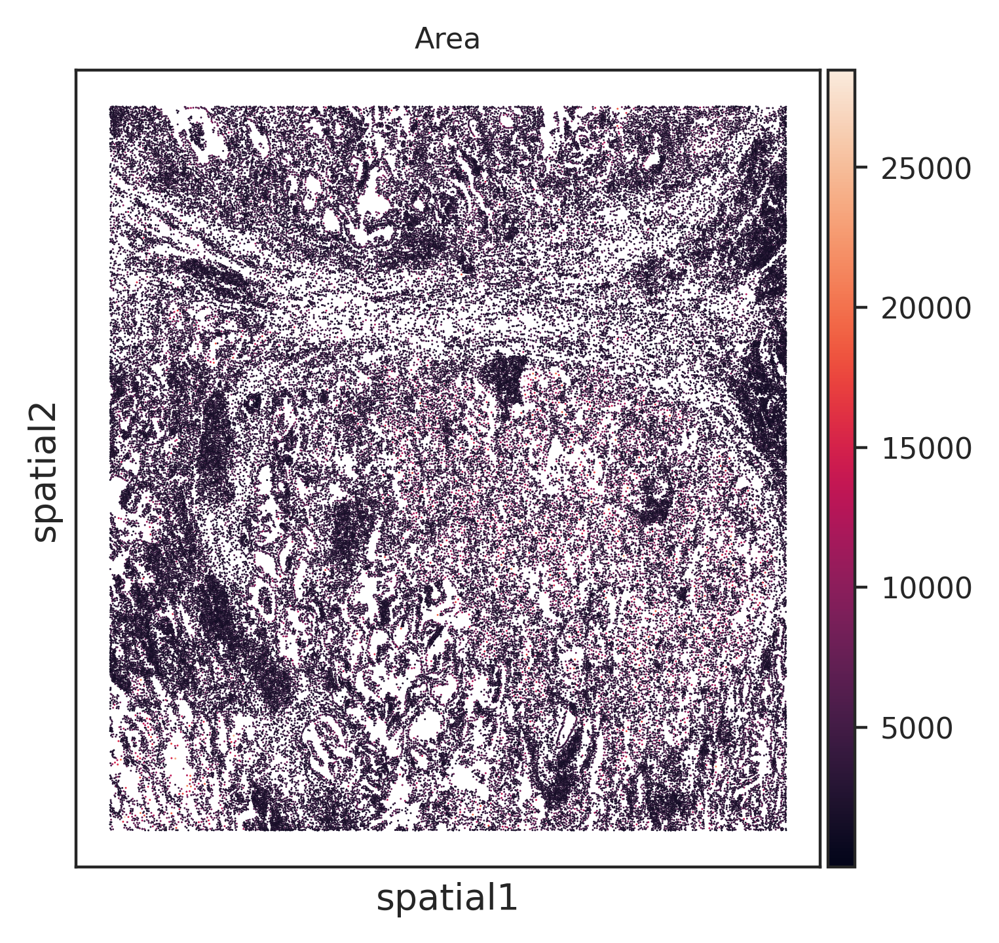

/tmp/ipykernel_1126531/2907380336.py:34: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = ad.AnnData(X=X)


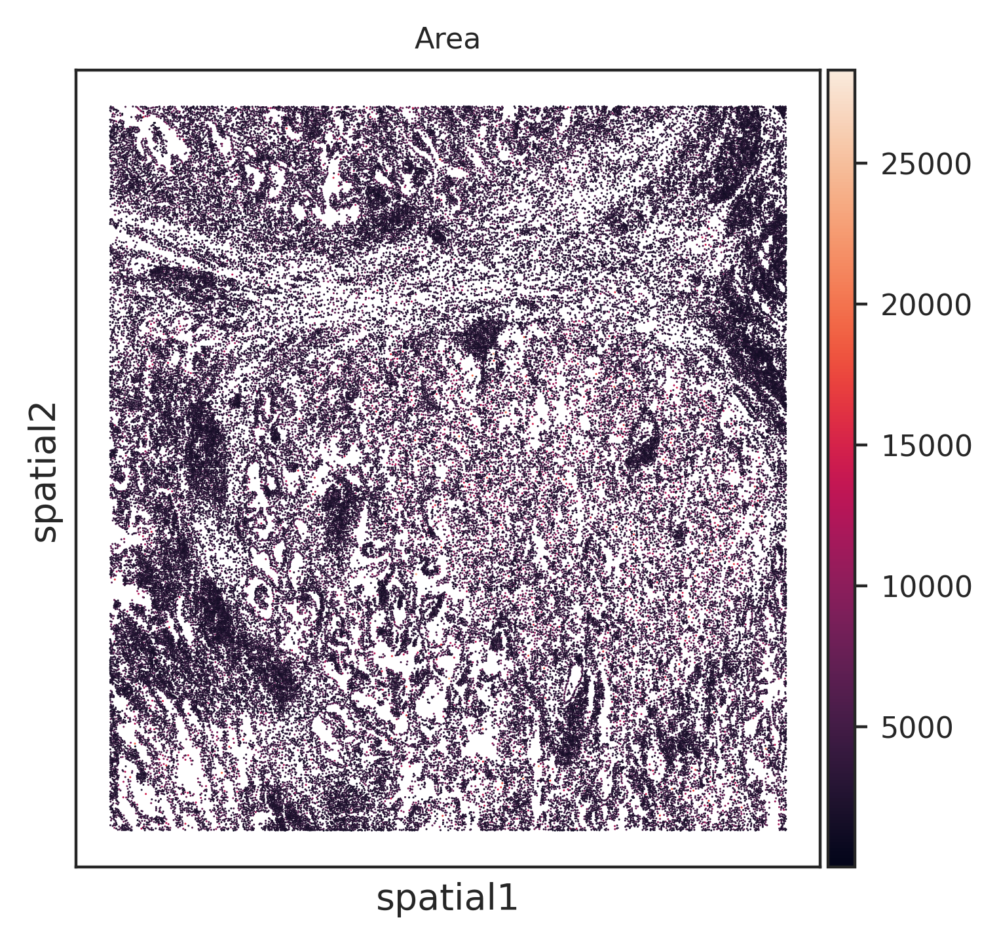

/tmp/ipykernel_1126531/2907380336.py:34: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = ad.AnnData(X=X)


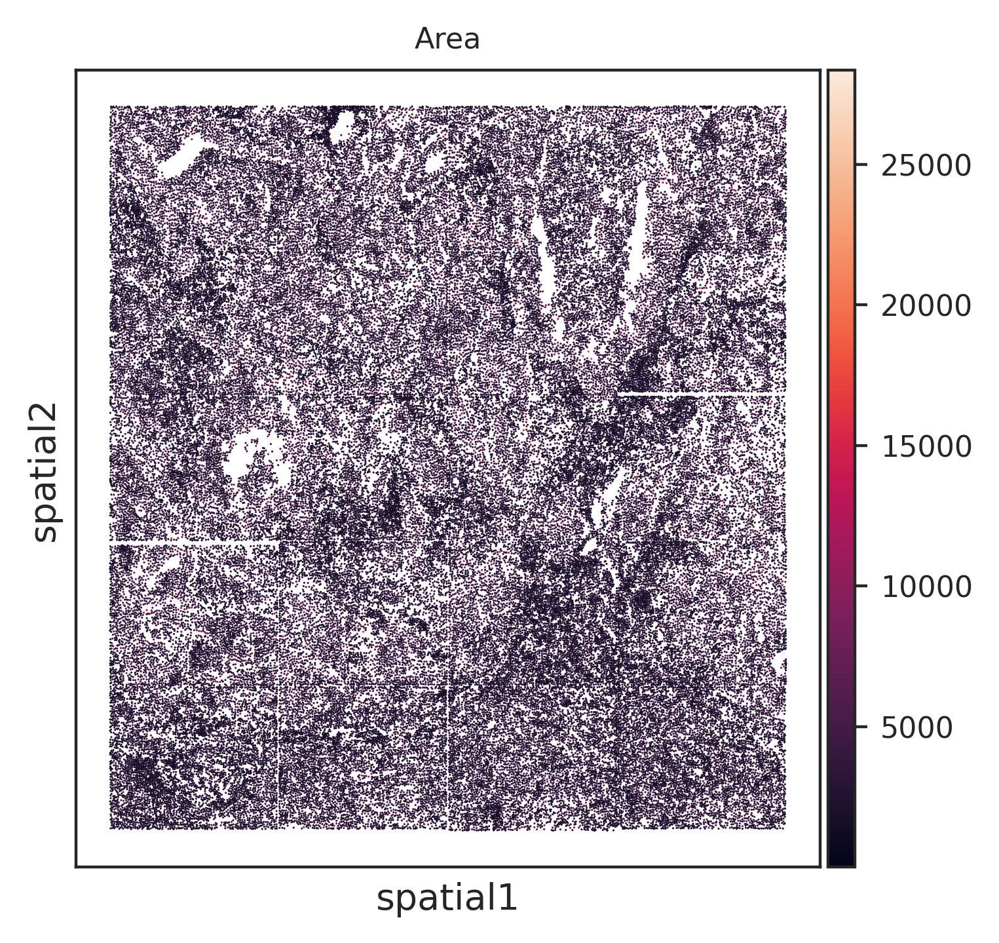

/tmp/ipykernel_1126531/2907380336.py:34: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = ad.AnnData(X=X)


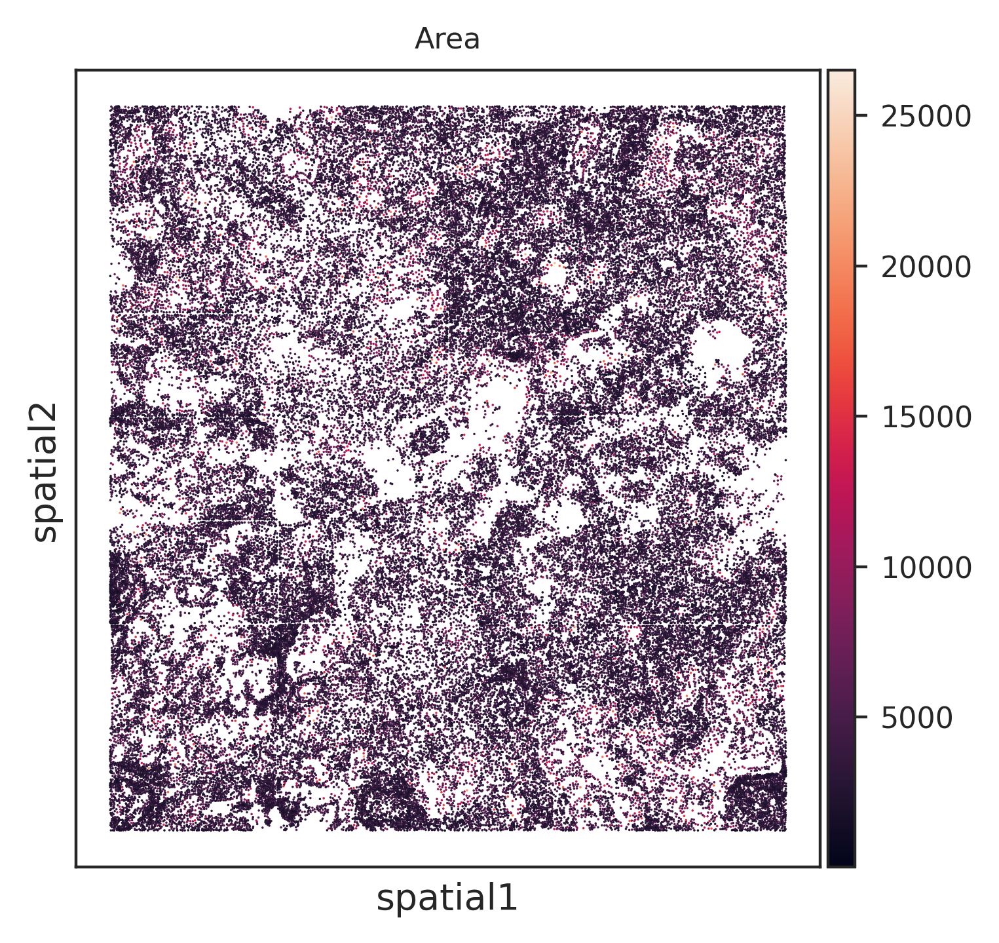

/tmp/ipykernel_1126531/2907380336.py:34: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = ad.AnnData(X=X)


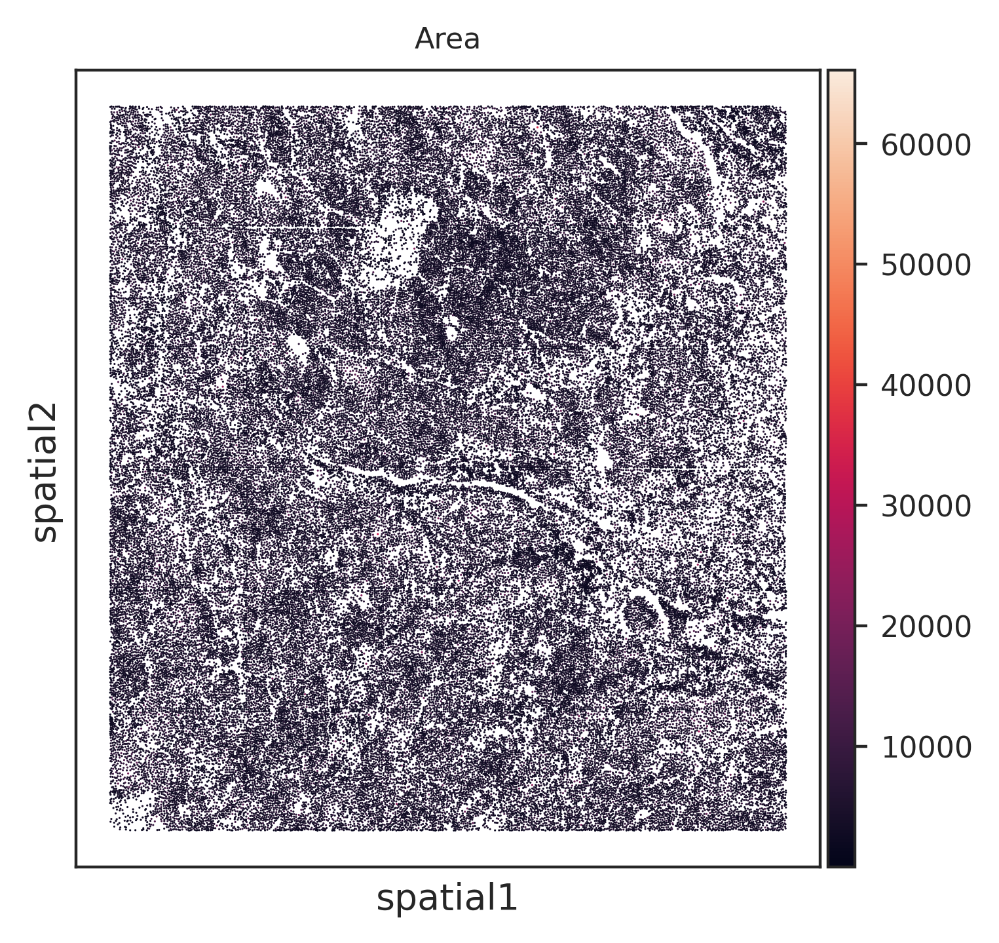

/tmp/ipykernel_1126531/2907380336.py:34: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = ad.AnnData(X=X)


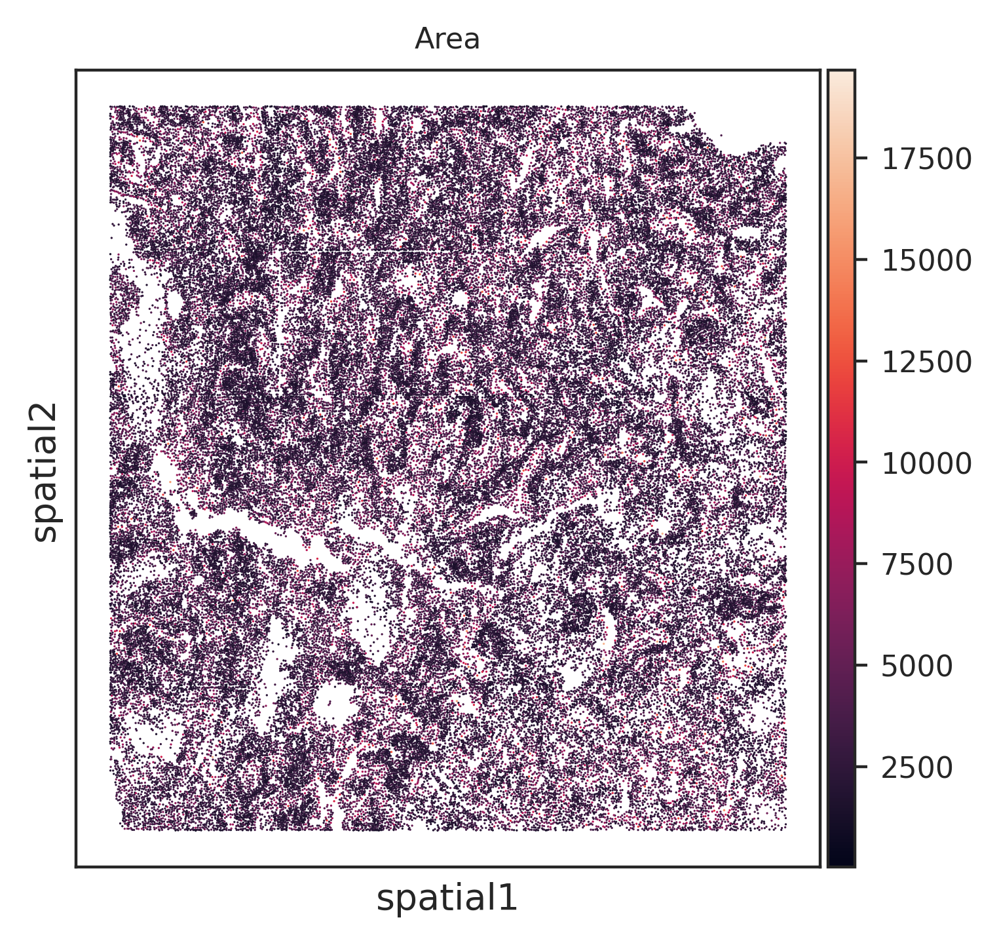

/tmp/ipykernel_1126531/2907380336.py:34: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = ad.AnnData(X=X)


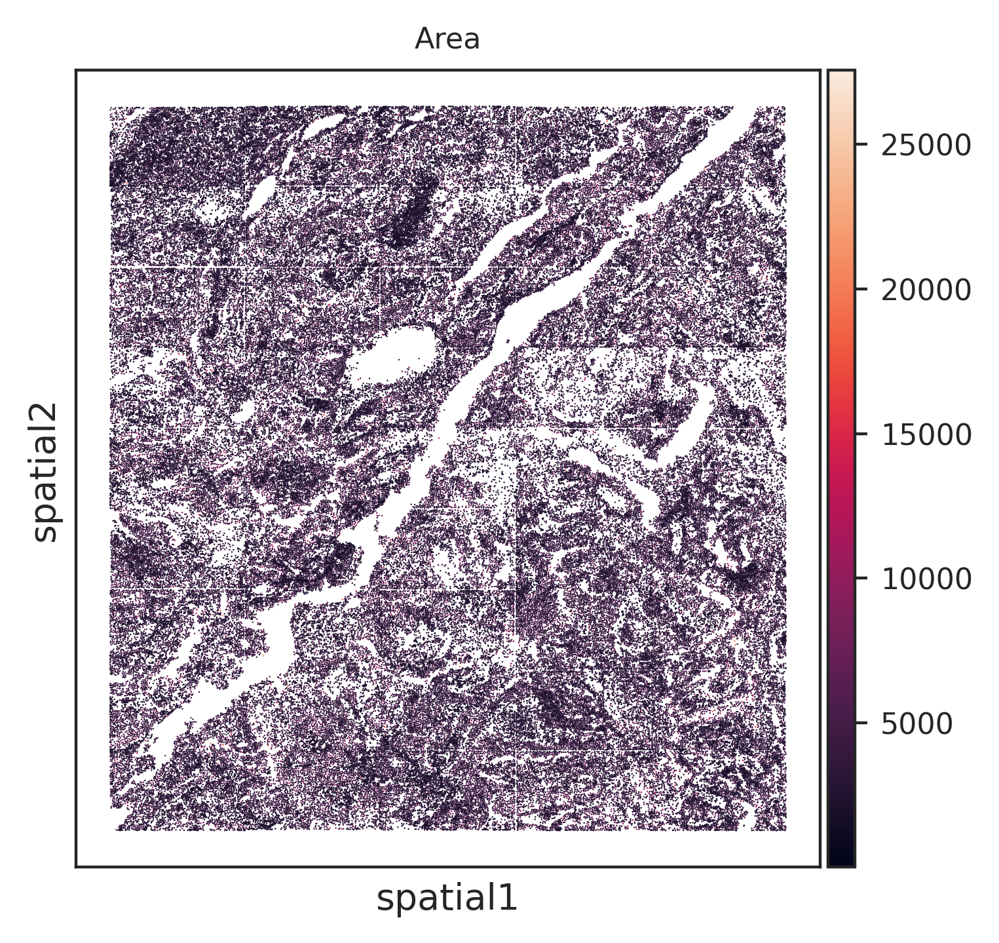

/tmp/ipykernel_1126531/2907380336.py:34: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = ad.AnnData(X=X)


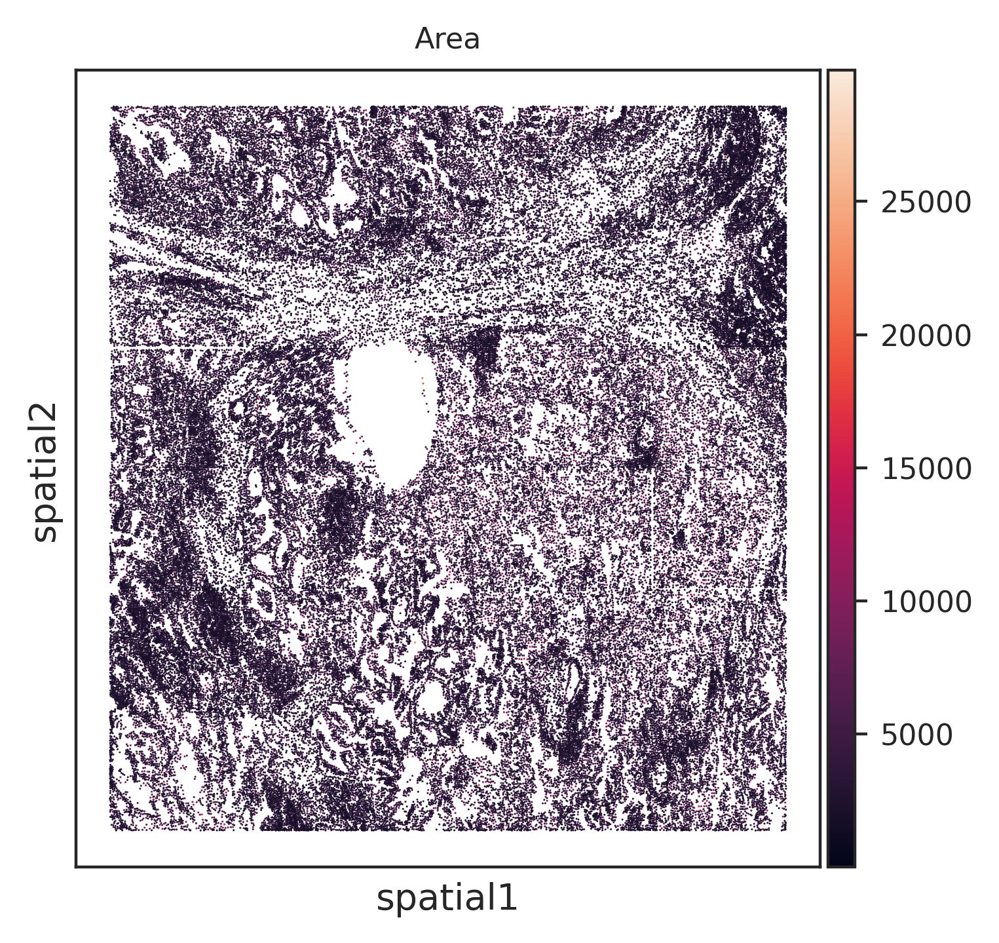

In [57]:
for ii in range(len(sample_list)):
    exprMat_pd = pd.read_csv(f'{path}/raw/{sample_list[ii]}/{exprMat}',delimiter=',')
    fovPos_pd =  pd.read_csv(f'{path}/raw/{sample_list[ii]}/{fovPos}',delimiter=',')
    metaData_pd =  pd.read_csv(f'{path}/raw/{sample_list[ii]}/{metaData}',delimiter=',')
    tx_pd =  pd.read_csv(f'{path}/raw/{sample_list[ii]}/{tx}',delimiter=',')


    exprMat_pd_index = []
    for i in range(len(exprMat_pd)):
        fov = exprMat_pd.loc[i,'fov']
        cell_ID = exprMat_pd.loc[i,'cell_ID']
        exprMat_pd_index.append(f'{fov}_{cell_ID}')


    metaData_pd_index = []
    for i in range(len(metaData_pd)):
        fov = metaData_pd.loc[i,'fov']
        cell_ID = metaData_pd.loc[i,'cell_ID']
        metaData_pd_index.append(f'{fov}_{cell_ID}')

    exprMat_pd['index'] = exprMat_pd_index
    exprMat_pd = exprMat_pd.set_index('index')

    metaData_pd['index'] = metaData_pd_index
    metaData_pd = metaData_pd.set_index('index')

    exprMat_pd = exprMat_pd.loc[metaData_pd.index]


    var_names = exprMat_pd.columns[2:]
    obs_names = exprMat_pd.index
    X = exprMat_pd.values[:,2:]

    adata = ad.AnnData(X=X)
    adata.obs_names = obs_names
    adata.var_names = var_names
    for obs in metaData_pd.columns:
        adata.obs[obs] = metaData_pd[[obs]]

    adata.obsm['spatial'] = np.array(metaData_pd[['CenterX_global_px','CenterY_global_px']]).astype('float')

    sc.pl.embedding(adata,basis='spatial',color='Area')
    adata.write_h5ad(f'{path}/h5ad/{sample_list[ii]}.h5ad')